In [1]:
from numpy import *
import pandas as pd
import random
import operator
import sys
import timeit
import itertools 
import colorsys
from math import sqrt
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from collections import defaultdict
from optparse import OptionParser
from heapq import heappush, heappop

## Load Data

In [2]:
cho = pd.read_csv('cho.txt', header = None, delimiter="\t")
iyer = pd.read_csv('iyer.txt', header = None, delimiter="\t")
cluster = cho[1]
cluster2 = iyer[1]
X = cho.iloc[:, 2:]
X = X.to_numpy()
Y = iyer.iloc[:, 2:]
Y = Y.to_numpy()
cluster = cluster.to_numpy()
clusterY = cluster2.to_numpy()

## Library Implementation

In [3]:
def LibraryHAC(n_components, X):
    hac = AgglomerativeClustering(n_components, affinity='euclidean', linkage = 'single')
    hac.fit_predict(X)
    assigned_cluster = hac.labels_.reshape((X.shape[0],1)) 
    pca_data = PCA(n_components = 2).fit_transform(X)
    finalDf = concatenate((pca_data, assigned_cluster), axis = 1)
    finalDf = pd.DataFrame({'Component1': finalDf[:, 0], 'Component2': finalDf[:, 1], 'Target': finalDf[:, 2]})
    return finalDf

In [4]:
def drawGraphLibrary(finalDf, size):
    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(111) 
    ax.set_xlabel('Principal Component 1', fontsize = 15)
    ax.set_ylabel('Principal Component 2', fontsize = 15)
    ax.set_title('Library PCA', fontsize = 20)
    targets = [i for i in range(size)]
    colors  = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)]) for i in range(size)]
    for target, color in zip(targets,colors):
        indicesToKeep = finalDf['Target'] == target
        ax.scatter(finalDf.loc[indicesToKeep, 'Component1'], finalDf.loc[indicesToKeep, 'Component2'], c = color, s = 50)
    ax.legend(targets)
    ax.grid()

In [5]:
def drawGraph(finalDf, size):
    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(111) 
    ax.set_xlabel('Principal Component 1', fontsize = 15)
    ax.set_ylabel('Principal Component 2', fontsize = 15)
    ax.set_title('PCA', fontsize = 20)
    targets = [i for i in range(1, size+1)]
    colors  = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)]) for i in range(size)]
    for target, color in zip(targets,colors):
        indicesToKeep = finalDf['Target'] == target
        ax.scatter(finalDf.loc[indicesToKeep, 'Component1'], finalDf.loc[indicesToKeep, 'Component2'], c = color, s = 50)
    ax.legend(targets)
    ax.grid()

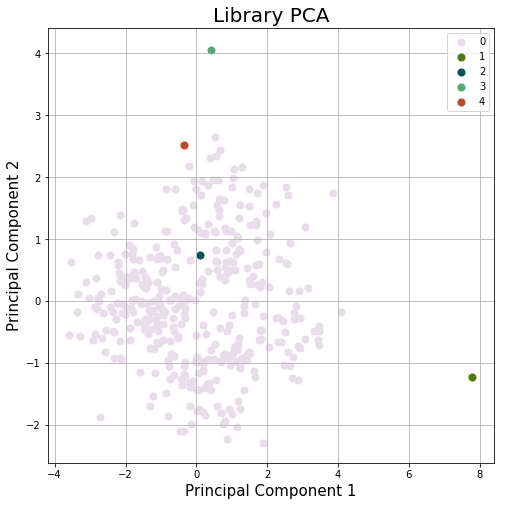

In [6]:
finalDf = LibraryHAC(5, X)
drawGraphLibrary(finalDf, 5)

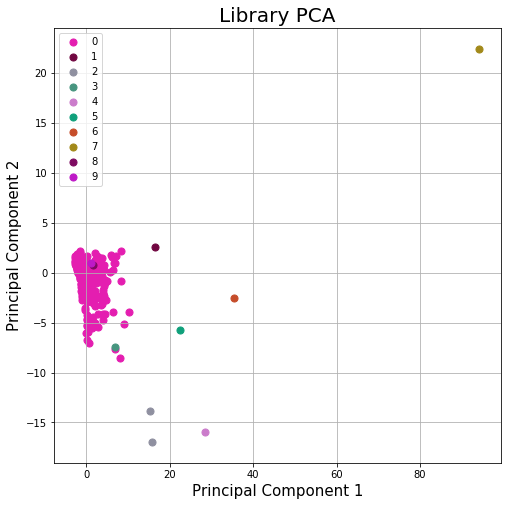

In [7]:
finalDf = LibraryHAC(10, Y)
drawGraphLibrary(finalDf, 10)

## Scratch Implmentation

In [8]:
class DisjointSet:
    _disjoint_set = list()

    def __init__(self, init_arr):
        self._disjoint_set = []
        if init_arr:
            for item in list(set(init_arr)):
                self._disjoint_set.append([item])

    def _find_index(self, elem):
        for item in self._disjoint_set:
            if elem in item:
                return self._disjoint_set.index(item)
        return None

    def find(self, elem):
        for item in self._disjoint_set:
            if elem in item:
                return self._disjoint_set[self._disjoint_set.index(item)]
        return None

    def union(self,elem1, elem2):
        index_elem1 = self._find_index(elem1)
        index_elem2 = self._find_index(elem2)
        if index_elem1 != index_elem2 and index_elem1 is not None and index_elem2 is not None:
            self._disjoint_set[index_elem2] = self._disjoint_set[index_elem2]+self._disjoint_set[index_elem1]
            del self._disjoint_set[index_elem1]
        return self._disjoint_set

    def get(self):
        return self._disjoint_set

    def getSize(self):
        return len(self._disjoint_set)

In [9]:
def euclidean_distance(u, v):
    diff = u - v
    return sqrt(dot(diff, diff))

def generateLabels(clusters,x):
    labels = zeros((x,), dtype=int)
    for i in range(len(clusters)):
        for j in range(len(clusters[i])):
            labels[clusters[i][j]] = i+1
    return labels

def hacAlgorithm(data, clustersSize):
    x,y = data.shape
    heap = []
    for i in range(x):
        for j in range(i+1,x):
            d = euclidean_distance(data[i],data[j])
            elems = [i,j]
            item = (d,elems)
            heappush(heap, item)
    test_set = DisjointSet([i for i in range(x)])
    print(heap)
    while heap:
        elems = heappop(heap)[1]
        test_set.union(elems[0],elems[1])
        print(test_set._disjoint_set)
        if clustersSize == test_set.getSize():
            break;
    
    labels = generateLabels(test_set.get(),shape(data)[0])
    pca_data = PCA(n_components = 2).fit_transform(data)
    labels = labels.reshape((labels.shape[0],1)) 
    finalDf = concatenate((pca_data, labels), axis = 1)
    finalDf = pd.DataFrame({'Component1': finalDf[:, 0], 'Component2': finalDf[:, 1], 'Target': finalDf[:, 2]})    
    return finalDf, labels

## Jaccard and Rand coefficients

In [10]:
def JaccardRand(cluster, assigned_cluster):
    ground_truth_matrix = zeros((len(assigned_cluster),len(assigned_cluster)))
    incidence_matrix = zeros((len(assigned_cluster),len(assigned_cluster)))

    for i in range(len(assigned_cluster)):
        for j in range(len(assigned_cluster)):
            ground_truth_matrix[i][j] = 1 if (assigned_cluster[i]==assigned_cluster[j]) else 0
            incidence_matrix[i][j] = 1 if (cluster[i]==cluster[j]) else 0
            
    m_1_1 = m_0_0 = m_1_0 = m_0_1 = 0.0
    for i in range(len(ground_truth_matrix)):
        for j in range(len(ground_truth_matrix)):
            if ground_truth_matrix[i][j] == incidence_matrix[i][j]:
                if ground_truth_matrix[i][j] == 1:
                    m_1_1 += 1
                else:
                    m_0_0 += 1
            else:
                if ground_truth_matrix[i][j] == 1:
                    m_1_0 += 1
                else:
                    m_0_1 += 1


    Jaccard = str(m_1_1 / (m_1_1 + m_1_0 + m_0_1))  
    Rand = str((m_1_1 + m_0_0) / (m_1_1 + m_0_0 + m_1_0 + m_0_1))
    print(f"The RAND coefficient is: {Rand}")
    print(f"The JACCARD coefficient is: {Jaccard}")

# Cho

[(0.0, [28, 298]), (0.5053642250891925, [69, 79]), (0.48921978700784374, [80, 87]), (0.6209259215075499, [110, 174]), (0.6729999999999999, [142, 184]), (0.6139739408150805, [75, 87]), (0.5308116426756293, [85, 232]), (0.6381723905027544, [343, 348]), (0.7709773018708139, [116, 154]), (0.7179763227293781, [16, 21]), (0.7300143834199433, [154, 192]), (0.6493104034281293, [75, 80]), (0.6190751166054085, [71, 165]), (0.6671768880889086, [221, 256]), (0.5863446085707619, [94, 174]), (0.701344423232979, [280, 299]), (0.6780634188628671, [320, 321]), (0.7955507526236149, [113, 142]), (0.9549162266921639, [127, 136]), (0.8490959898621594, [134, 272]), (0.7651437773386124, [127, 234]), (0.8804663537012644, [31, 142]), (0.7914821539365243, [3, 346]), (0.8170073439082418, [167, 273]), (0.6744634904870686, [75, 97]), (0.7748528892635042, [77, 84]), (0.6715802260340904, [197, 199]), (0.7618589108227323, [207, 208]), (0.6903984356876832, [87, 91]), (0.6460681078647978, [91, 201]), (0.636491162546660

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[4], [5], [7], [11], [13], [18], [22], [23], [25], [27], [29], [30], [35], [37], [38], [46, 0], [49], [52], [55], [59], [64], [65], [89], [107], [119], [123], [124], [125], [126], [128], [129], [138], [164], [168], [177], [194], [198], [215], [216], [217], [218], [219], [220], [227], [246], [248], [260], [261], [268], [271], [274], [296, 275, 250, 235, 106, 325, 347, 56, 358, 302, 172, 377, 344, 58, 179, 378, 156, 121, 188, 367, 43, 187, 17, 45, 2, 157, 191, 141, 385, 178, 176, 205, 204, 203, 289, 190, 331, 53, 189, 237, 133, 51, 32, 33, 145, 21, 16, 19, 15, 34, 111, 48, 14, 60, 50, 180, 132, 62, 371, 345, 348, 343, 333, 183, 160, 214, 162, 252, 122, 360, 382, 379, 337, 282, 332, 170, 61, 83, 10, 147, 139, 158, 294, 98, 175, 120, 238, 54, 384, 108, 334, 375, 315, 286, 381, 364, 336, 279, 359, 146, 152, 370, 276, 308, 313, 357, 231, 330, 323, 368, 352, 340, 351, 243, 329, 326, 287, 321, 320, 314, 291, 256, 221, 324, 341, 316, 317, 267, 278, 290, 226, 300, 327, 299, 280, 236, 328, 254, 

[[4], [7], [11], [13], [18], [22], [23], [25], [27], [29], [30], [35], [37], [38], [46, 0], [49], [52], [55], [59], [64], [65], [89], [107], [119], [123], [124], [125], [126], [128], [129], [138], [164], [168], [177], [194], [198], [215], [216], [217], [218], [219], [220], [227], [246], [248], [260], [261], [268], [271], [274], [304], [307], [310, 301], [311], [319, 366, 372, 338, 296, 275, 250, 235, 106, 325, 347, 56, 358, 302, 172, 377, 344, 58, 179, 378, 156, 121, 188, 367, 43, 187, 17, 45, 2, 157, 191, 141, 385, 178, 176, 205, 204, 203, 289, 190, 331, 53, 189, 237, 133, 51, 32, 33, 145, 21, 16, 19, 15, 34, 111, 48, 14, 60, 50, 180, 132, 62, 371, 345, 348, 343, 333, 183, 160, 214, 162, 252, 122, 360, 382, 379, 337, 282, 332, 170, 61, 83, 10, 147, 139, 158, 294, 98, 175, 120, 238, 54, 384, 108, 334, 375, 315, 286, 381, 364, 336, 279, 359, 146, 152, 370, 276, 308, 313, 357, 231, 330, 323, 368, 352, 340, 351, 243, 329, 326, 287, 321, 320, 314, 291, 256, 221, 324, 341, 316, 317, 267, 27

[[4], [7], [11], [13], [18], [25], [27], [29], [35], [37], [38], [46, 0], [49], [52], [55], [64], [65], [89], [107], [119], [123], [124], [125], [126], [128], [129], [138], [164], [177], [194], [198], [215], [217], [218], [219], [227], [246], [248], [260], [261], [268], [271, 59, 168, 319, 366, 372, 338, 296, 275, 250, 235, 106, 325, 347, 56, 358, 302, 172, 377, 344, 58, 179, 378, 156, 121, 188, 367, 43, 187, 17, 45, 2, 157, 191, 141, 385, 178, 176, 205, 204, 203, 289, 190, 331, 53, 189, 237, 133, 51, 32, 33, 145, 21, 16, 19, 15, 34, 111, 48, 14, 60, 50, 180, 132, 62, 371, 345, 348, 343, 333, 183, 160, 214, 162, 252, 122, 360, 382, 379, 337, 282, 332, 170, 61, 83, 10, 147, 139, 158, 294, 98, 175, 120, 238, 54, 384, 108, 334, 375, 315, 286, 381, 364, 336, 279, 359, 146, 152, 370, 276, 308, 313, 357, 231, 330, 323, 368, 352, 340, 351, 243, 329, 326, 287, 321, 320, 314, 291, 256, 221, 324, 341, 316, 317, 267, 278, 290, 226, 300, 327, 299, 280, 236, 328, 254, 297, 288, 225, 269, 284, 322, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[25], [29], [35], [89], [107], [125], [126], [129], [198], [227], [369], [373, 268, 380, 355, 248, 194, 164, 361, 49, 215, 138, 274, 218, 177, 376, 356, 128, 349, 246, 123, 307, 271, 59, 168, 319, 366, 372, 338, 296, 275, 250, 235, 106, 325, 347, 56, 358, 302, 172, 377, 344, 58, 179, 378, 156, 121, 188, 367, 43, 187, 17, 45, 2, 157, 191, 141, 385, 178, 176, 205, 204, 203, 289, 190, 331, 53, 189, 237, 133, 51, 32, 33, 145, 21, 16, 19, 15, 34, 111, 48, 14, 60, 50, 180, 132, 62, 371, 345, 348, 343, 333, 183, 160, 214, 162, 252, 122, 360, 382, 379, 337, 282, 332, 170, 61, 83, 10, 147, 139, 158, 294, 98, 175, 120, 238, 54, 384, 108, 334, 375, 315, 286, 381, 364, 336, 279, 359, 146, 152, 370, 276, 308, 313, 357, 231, 330, 323, 368, 352, 340, 351, 243, 329, 326, 287, 321, 320, 314, 291, 256, 221, 324, 341, 316, 317, 267, 278, 290, 226, 300, 327, 299, 280, 236, 328, 254, 297, 288, 225, 269, 284, 322, 309, 253, 255, 281, 285, 277, 136, 265, 208, 207, 234, 127, 258, 263, 166, 165, 71, 195, 272,

[[25], [29], [35], [89], [107], [125], [126], [129], [198], [227], [369], [373, 268, 380, 355, 248, 194, 164, 361, 49, 215, 138, 274, 218, 177, 376, 356, 128, 349, 246, 123, 307, 271, 59, 168, 319, 366, 372, 338, 296, 275, 250, 235, 106, 325, 347, 56, 358, 302, 172, 377, 344, 58, 179, 378, 156, 121, 188, 367, 43, 187, 17, 45, 2, 157, 191, 141, 385, 178, 176, 205, 204, 203, 289, 190, 331, 53, 189, 237, 133, 51, 32, 33, 145, 21, 16, 19, 15, 34, 111, 48, 14, 60, 50, 180, 132, 62, 371, 345, 348, 343, 333, 183, 160, 214, 162, 252, 122, 360, 382, 379, 337, 282, 332, 170, 61, 83, 10, 147, 139, 158, 294, 98, 175, 120, 238, 54, 384, 108, 334, 375, 315, 286, 381, 364, 336, 279, 359, 146, 152, 370, 276, 308, 313, 357, 231, 330, 323, 368, 352, 340, 351, 243, 329, 326, 287, 321, 320, 314, 291, 256, 221, 324, 341, 316, 317, 267, 278, 290, 226, 300, 327, 299, 280, 236, 328, 254, 297, 288, 225, 269, 284, 322, 309, 253, 255, 281, 285, 277, 136, 265, 208, 207, 234, 127, 258, 263, 166, 165, 71, 195, 272,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[29], [35], [126], [129], [369, 198, 373, 268, 380, 355, 248, 194, 164, 361, 49, 215, 138, 274, 218, 177, 376, 356, 128, 349, 246, 123, 307, 271, 59, 168, 319, 366, 372, 338, 296, 275, 250, 235, 106, 325, 347, 56, 358, 302, 172, 377, 344, 58, 179, 378, 156, 121, 188, 367, 43, 187, 17, 45, 2, 157, 191, 141, 385, 178, 176, 205, 204, 203, 289, 190, 331, 53, 189, 237, 133, 51, 32, 33, 145, 21, 16, 19, 15, 34, 111, 48, 14, 60, 50, 180, 132, 62, 371, 345, 348, 343, 333, 183, 160, 214, 162, 252, 122, 360, 382, 379, 337, 282, 332, 170, 61, 83, 10, 147, 139, 158, 294, 98, 175, 120, 238, 54, 384, 108, 334, 375, 315, 286, 381, 364, 336, 279, 359, 146, 152, 370, 276, 308, 313, 357, 231, 330, 323, 368, 352, 340, 351, 243, 329, 326, 287, 321, 320, 314, 291, 256, 221, 324, 341, 316, 317, 267, 278, 290, 226, 300, 327, 299, 280, 236, 328, 254, 297, 288, 225, 269, 284, 322, 309, 253, 255, 281, 285, 277, 136, 265, 208, 207, 234, 127, 258, 263, 166, 165, 71, 195, 272, 134, 230, 270, 239, 229, 109, 149, 

The RAND coefficient is: 0.24027490670890495
The JACCARD coefficient is: 0.22839497757358454


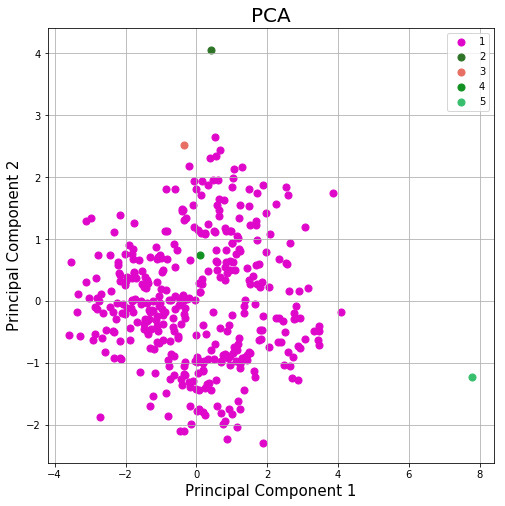

In [11]:
finalDf, labels = hacAlgorithm(X,5)
drawGraph(finalDf, 5)
JaccardRand(cluster, labels)

# Iyer

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[0], [1], [2], [5], [6], [7], [11], [14], [17], [25], [35], [42], [50], [55], [63, 4], [64], [67], [75], [81, 27], [82], [84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31, 138, 136, 172, 140, 135, 134, 30, 111, 212, 215, 210, 178, 157, 169, 154, 148, 20, 19, 62, 3, 13, 177, 137, 160, 130, 209, 176, 28, 129, 18, 52, 38, 36, 282, 281, 66, 29, 123, 16, 46, 34, 76, 9, 51, 245, 49, 96, 95, 41, 12, 88, 33, 280, 74, 8, 128, 39, 194, 241, 48, 40, 182, 97], [87], [93], [100], [101], [102], [103], [105], [106], [107], [108], [109], [110], [115], [116], [117], [122, 121], [124], [125], 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[1], [101], [218], [220], [253], [256], [257], [258], [261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31, 138, 136, 172, 140, 135, 134, 30, 111, 212, 215, 210, 178, 157, 169, 154, 148, 20, 19, 62, 3, 13, 177, 137, 160, 130, 209, 1

[[1], [101], [218], [220], [253], [256], [257], [258], [261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31, 138, 136, 172, 140, 135, 134, 30, 111, 212, 215, 210, 178, 157, 169, 154, 148, 20, 19, 62, 3, 13, 177, 137, 160, 130, 209, 17

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[101], [218], [220], [253], [257], [258], [262], [263], [264], [275], [285], [286], [288, 287], [289], [290], [291], [292], [293], [295], [296], [297], [298], [299], [300], [301], [307], [308], [310], [311], [312], [313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[101], [218], [258], [262], [263], [264], [285], [290], [291], [292], [293], [296], [297], [299], [307, 300], [310], [311, 308], [312], [314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 3

[[101], [218], [258], [262], [263], [264], [285], [290], [291], [292], [293], [296], [297], [299], [307, 300], [310], [311, 308], [312], [314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31

[[101], [218], [258], [262], [263], [264], [285], [290], [291], [292], [293], [296], [297], [299], [307, 300], [310], [311, 308], [312], [314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31

[[101], [218], [258], [262], [263], [264], [285], [290], [291], [292], [293], [296], [297], [299], [307, 300], [310], [311, 308], [312], [314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31

[[101], [218], [258], [262], [263], [264], [285], [290], [291], [292], [293], [296], [297], [299], [307, 300], [310], [311, 308], [312], [314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[101], [258], [262], [263], [264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31, 138, 136, 172, 140, 135, 134, 30, 111, 212, 215, 210, 178, 157, 169, 154, 14

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[101], [258], [262], [263], [285], [290], [291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31, 138, 136, 172, 140, 135, 134, 30, 111, 212, 21

[[101], [262], [263], [285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83, 164, 242, 54, 80, 156, 155, 15, 196, 132, 167, 180, 86, 139, 166, 225, 214, 213, 179, 112, 181, 45, 44, 159, 168, 158, 53, 69, 60, 77, 21, 142, 57, 43, 37, 58, 23, 22, 171, 170, 161, 198, 133, 32, 192, 31, 138, 136, 172, 140, 135, 134, 30, 111, 212, 215, 210, 178,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[262], [263], [290], [292], [310], [320], [324], [325], [326], [327], [328, 323], [333], [334], [337, 332, 331], [338], [341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[262], [263], [292], [310], [320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 1

[[262], [263], [310], [320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195, 55, 84, 222, 229, 184, 227, 99, 92, 244, 85, 268, 197, 26, 114, 315, 113, 254, 249, 47, 219, 199, 173, 65, 56, 143, 240, 151, 153, 193, 238, 237, 145, 162, 183, 234, 131, 174, 94, 146, 91, 90, 89, 61, 59, 165, 98, 78, 71, 70, 24, 283, 10, 73, 72, 79, 68, 163, 83,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[262], [263], [325], [326, 324], [327], [333], [334], [337, 332, 331, 310], [338, 328, 323], [342], [343], [344], [345], [346, 292], [347], [348], [349], [350], [351], [352], [353], [354], [355], [356], [359], [360], [361], [362], [363], [364], [365], [367], [368], [369, 366], [370], [373], [374], [376], [377], [378], [383], [386], [388, 387, 372], [389], [391], [392], [395], [397], [398], [400, 399], [407], [411], [415], [419], [424], [434], [435], [437], [439, 438], [440], [441], [444], [445], [446], [448], [449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[262], [263], [325], [333, 327, 326, 324], [334], [338, 328, 323], [343], [344], [345], [346, 292], [347], [348], [349], [350], [351], [352], [355], [356], [359], [360], [361], [362], [363], [364], [365, 353], [367], [368], [370], [374], [377], [378], [383], [389], [391], [392], [395], [397, 337, 332, 331, 310], [398], [407], [411], [415], [424], [434], [435], [439, 438, 437], [440], [441], [444], [445], [446], [448, 400, 399], [455], [456], [457], [463], [464], [468, 427, 426], [469], [470], [471], [472], [480], [481], [482], [483], [484], [485, 386], [486], [488, 487], [489], [490], [491], [492], [493], [499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 

[[262], [263], [325], [333, 327, 326, 324], [334], [338, 328, 323], [343], [344], [345], [346, 292], [347], [348], [349], [350], [351], [352], [355], [356], [359], [360], [361], [362], [363], [364], [365, 353], [367], [368], [370], [374], [377], [378], [383], [389], [391], [392], [395], [397, 337, 332, 331, 310], [398], [407], [411], [415], [424], [434], [435], [439, 438, 437], [440], [441], [444], [445], [446], [455], [456], [457], [463], [464], [468, 427, 426], [469], [470], [471], [472], [480], [481], [482], [483], [484], [485, 386], [486], [488, 487], [489], [490], [491], [492], [493], [499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 31

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[262], [263], [343], [344], [345], [347], [348], [349], [351], [356], [359], [360], [361], [362], [367], [368], [374], [377], [378], [391], [392], [395], [407], [411], [424], [434], [440], [441], [445], [446], [456], [457], [464], [469], [470], [471], [472], [480], [481], [489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 24

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[262], [263], [347], [348, 345], [349], [360], [361], [362], [367], [368], [374], [378, 377], [424], [434], [440], [441], [445], [469], [470], [471], [472], [490], [491], [500], [502], [503], [505], [508], [512, 481, 492, 407, 507, 506, 351, 480, 356, 457, 489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204

[[263], [347], [348, 345], [349], [360], [361], [362], [367], [368], [374], [378, 377], [424], [434], [440], [441], [469, 445], [470], [471], [472], [490], [491], [500], [502], [503], [505], [508], [512, 481, 492, 407, 507, 506, 351, 480, 356, 457, 489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[263], [347], [349], [362], [368], [374, 516, 514, 515, 513, 360, 348, 345, 512, 481, 492, 407, 507, 506, 351, 480, 356, 457, 489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[263], [347], [349], [362], [440, 434], [441], [469, 445], [470], [471], [472], [490], [491], [503, 368, 502, 500, 374, 516, 514, 515, 513, 360, 348, 345, 512, 481, 492, 407, 507, 506, 351, 480, 356, 457, 489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[263, 440, 434, 503, 368, 502, 500, 374, 516, 514, 515, 513, 360, 348, 345, 512, 481, 492, 407, 507, 506, 351, 480, 356, 457, 489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195

[[263, 440, 434, 503, 368, 502, 500, 374, 516, 514, 515, 513, 360, 348, 345, 512, 481, 492, 407, 507, 506, 351, 480, 356, 457, 489, 363, 435, 439, 438, 437, 468, 427, 426, 511, 504, 510, 497, 488, 487, 346, 292, 482, 486, 365, 353, 352, 383, 501, 499, 342, 369, 366, 354, 376, 373, 449, 320, 290, 495, 298, 299, 422, 341, 340, 339, 335, 301, 336, 330, 467, 421, 396, 393, 321, 312, 319, 479, 476, 478, 496, 477, 473, 406, 454, 452, 443, 447, 462, 461, 460, 459, 451, 450, 453, 403, 401, 402, 394, 430, 418, 465, 458, 423, 412, 405, 404, 442, 297, 420, 285, 258, 291, 329, 322, 264, 417, 293, 318, 311, 308, 314, 286, 220, 257, 416, 289, 253, 295, 313, 261, 269, 259, 252, 303, 221, 267, 224, 294, 276, 5, 306, 260, 255, 266, 277, 248, 274, 250, 200, 498, 236, 152, 149, 87, 93, 316, 270, 175, 284, 279, 251, 273, 189, 226, 127, 150, 63, 4, 247, 216, 246, 231, 217, 204, 317, 104, 82, 17, 278, 272, 67, 35, 309, 187, 230, 190, 100, 232, 191, 141, 122, 121, 235, 223, 207, 305, 304, 208, 206, 205, 195,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



KeyboardInterrupt: 

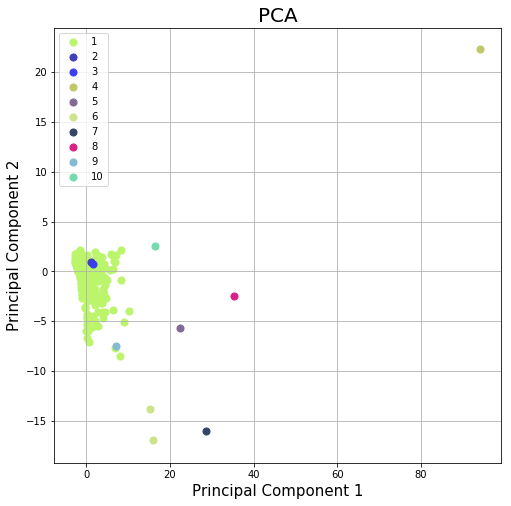

In [12]:
finalDf, labels = hacAlgorithm(Y, 10)
drawGraph(finalDf, 10)
JaccardRand(cluster2, labels)

### Dataset 2

In [13]:
data = pd.read_csv('new_dataset_2.txt', header = None, delimiter="\t")
cluster_X = data[1]
data_X = data.iloc[:, 2:]
data_X = data_X.to_numpy()
cluster_X = cluster_X.to_numpy()

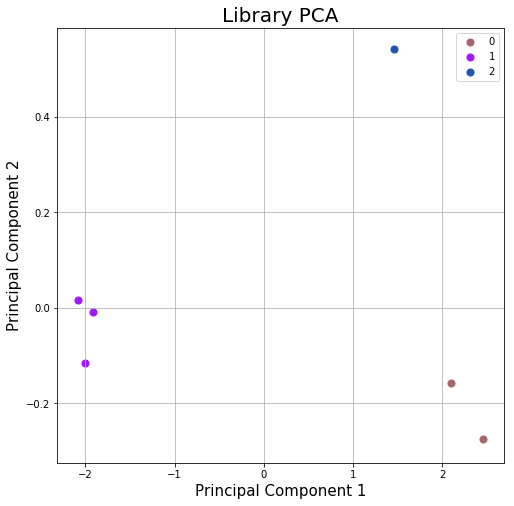

In [14]:
finalDf = LibraryHAC(3, data_X)
drawGraphLibrary(finalDf, 3)

[(0.14038326716528582, [0, 1]), (0.15052802064732002, [0, 2]), (0.16632704981451457, [1, 2]), (4.019448692283557, [1, 5]), (3.5749500321403094, [2, 3]), (1.2912263187760695, [3, 4]), (0.37426893565990754, [4, 5]), (4.466244695714734, [0, 4]), (4.380266972833962, [1, 4]), (4.108125356656002, [0, 5]), (4.545961403949664, [2, 4]), (4.184764488259764, [2, 5]), (3.524640465735477, [0, 3]), (3.416259772060667, [1, 3]), (0.9512643704564993, [3, 5])]
[[1, 0], [2], [3], [4], [5]]
[[2, 1, 0], [3], [4], [5]]
[[2, 1, 0], [3], [4], [5]]
[[2, 1, 0], [3], [5, 4]]
The RAND coefficient is: 0.8888888888888888
The JACCARD coefficient is: 0.7777777777777778


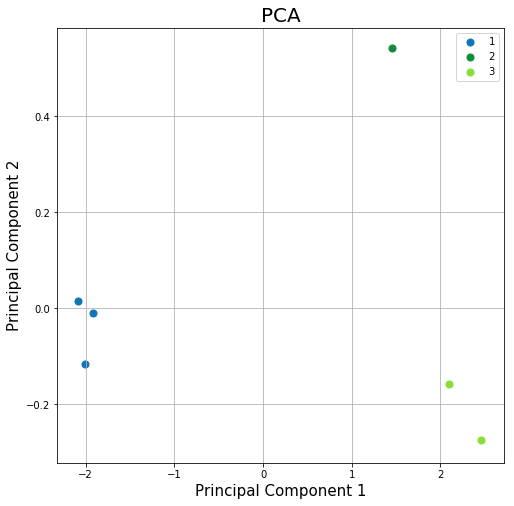

In [15]:
finalDf, labels = hacAlgorithm(data_X, 3)
drawGraph(finalDf, 3)
JaccardRand(cluster_X, labels)